## Final Project Submission

Please fill out:
* Student name: Troy Hendrickson
* Student pace: Full time
* Scheduled project review date/time: October 28, 2022
* Instructor name: Joseph Mata
* Blog post URL: https://troykhendrix22.blogspot.com/


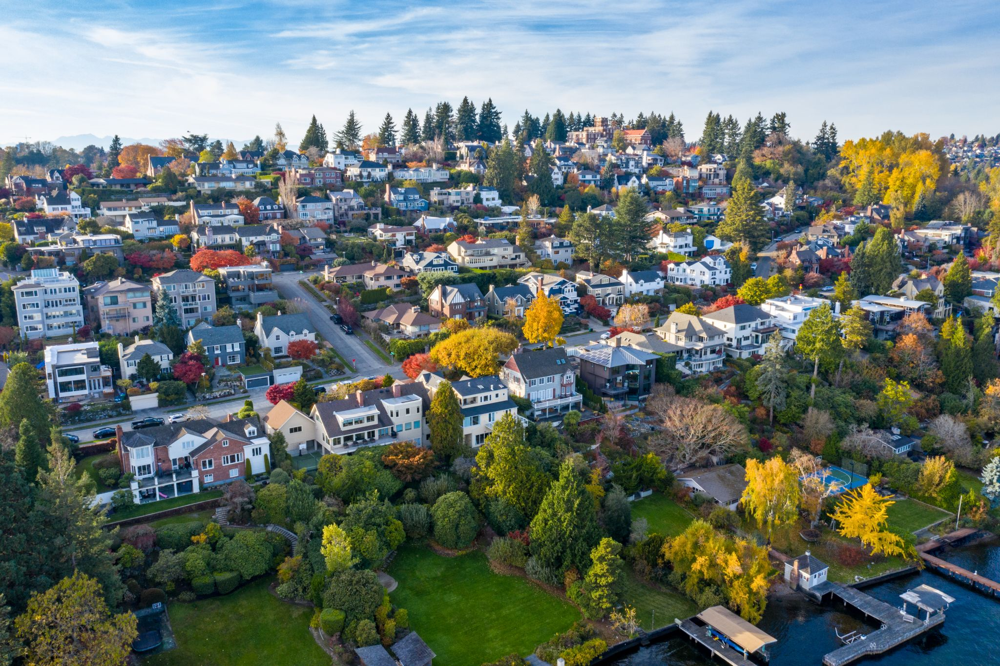

# Objective
The goal of this project is to analyze housing data in King County, Washington to figure out what features have an impact on the sale price, create a linear regression model that can predict price by inputing these features, and then use this data to solve some real world problem. Along the way we will need to clean our data, do some feature engineering, explain and display our work/findings via models and graphs.

# Business Problem

A newlywed couple has recently started their new journey together. The first thing that these high school sweethearts would like to do is build a family in their brand new home in the city of Kings County where they were both born and raised. They are specific in their requests in which they’d want a 3 bedroom home with about a $500,000 budget. It is my goal to give the best predictions of the homes in the area and help these first time home buyers understand how price of a home can change depending on its features and parameters using data science and data analytics.

# Initializing the Dataset 

## Library Imports

In [142]:
#Basics
import numpy as np
import pandas as pd
from IPython.display import Markdown, display
# Data visualizations
import matplotlib.pyplot as plt
import seaborn as sns
import plotly.express as px
from matplotlib.ticker import StrMethodFormatter
# Pre-Processing
from sklearn.model_selection import train_test_split
from sklearn.preprocessing import MinMaxScaler
from sklearn.preprocessing import StandardScaler
from sklearn.preprocessing import OneHotEncoder
from sklearn.preprocessing import PolynomialFeatures
from sklearn.preprocessing import OrdinalEncoder
# Metrics
from sklearn.linear_model import LinearRegression
from sklearn.model_selection import cross_validate, ShuffleSplit
import statsmodels.api as sm
from sklearn.metrics import r2_score, mean_squared_error, mean_absolute_error

In [143]:
# import data set as a dataframe
df = pd.read_csv('data/kc_house_data.csv')
df.head()

,id,date,price,bedrooms,bathrooms,sqft_living,sqft_lot,floors,waterfront,view,...,grade,sqft_above,sqft_basement,yr_built,yr_renovated,zipcode,lat,long,sqft_living15,sqft_lot15
0,7129300520,10/13/2014,221900.0,3,1.00,1180,5650,1.0,NaN,NONE,...,7 Average,1180,0.0,1955,0.0,98178,47.5112,-122.257,1340,5650
1,6414100192,12/9/2014,538000.0,3,2.25,2570,7242,2.0,NO,NONE,...,7 Average,2170,400.0,1951,1991.0,98125,47.7210,-122.319,1690,7639
2,5631500400,2/25/2015,180000.0,2,1.00,770,10000,1.0,NO,NONE,...,6 Low Average,770,0.0,1933,NaN,98028,47.7379,-122.233,2720,8062
3,2487200875,12/9/2014,604000.0,4,3.00,1960,5000,1.0,NO,NONE,...,7 Average,1050,910.0,1965,0.0,98136,47.5208,-122.393,1360,5000
4,1954400510,2/18/2015,510000.0,3,2.00,1680,8080,1.0,NO,NONE,...,8 Good,1680,0.0,1987,0.0,98074,47.6168,-122.045,1800,7503


In [144]:
# load in the markdown file for column names and descriptions
display(Markdown("data/column_names.md"))

# Column Names and Descriptions for King County Data Set
* `id` - Unique identifier for a house
* `date` - Date house was sold
* `price` - Sale price (prediction target)
* `bedrooms` - Number of bedrooms
* `bathrooms` - Number of bathrooms
* `sqft_living` - Square footage of living space in the home
* `sqft_lot` - Square footage of the lot
* `floors` - Number of floors (levels) in house
* `waterfront` - Whether the house is on a waterfront
  * Includes Duwamish, Elliott Bay, Puget Sound, Lake Union, Ship Canal, Lake Washington, Lake Sammamish, other lake, and river/slough waterfronts
* `view` - Quality of view from house
  * Includes views of Mt. Rainier, Olympics, Cascades, Territorial, Seattle Skyline, Puget Sound, Lake Washington, Lake Sammamish, small lake / river / creek, and other
* `condition` - How good the overall condition of the house is. Related to maintenance of house.
  * See the [King County Assessor Website](https://info.kingcounty.gov/assessor/esales/Glossary.aspx?type=r) for further explanation of each condition code
* `grade` - Overall grade of the house. Related to the construction and design of the house.
  * See the [King County Assessor Website](https://info.kingcounty.gov/assessor/esales/Glossary.aspx?type=r) for further explanation of each building grade code
* `sqft_above` - Square footage of house apart from basement
* `sqft_basement` - Square footage of the basement
* `yr_built` - Year when house was built
* `yr_renovated` - Year when house was renovated
* `zipcode` - ZIP Code used by the United States Postal Service
* `lat` - Latitude coordinate
* `long` - Longitude coordinate
* `sqft_living15` - The square footage of interior housing living space for the nearest 15 neighbors
* `sqft_lot15` - The square footage of the land lots of the nearest 15 neighbors


## Exploratory Data Analysis


- After checking the dataframe's information we proceed to do some data cleaning and exploratory data an analysis.

In [145]:
#Check numnber of rows and columns 
df.shape

(21597, 21)

In [146]:
#Describe the dataframe 
df.describe()

,id,price,bedrooms,bathrooms,sqft_living,sqft_lot,floors,sqft_above,yr_built,yr_renovated,zipcode,lat,long,sqft_living15,sqft_lot15
count,2.159700e+04,2.159700e+04,21597.000000,21597.000000,21597.000000,2.159700e+04,21597.000000,21597.000000,21597.000000,17755.000000,21597.000000,21597.000000,21597.000000,21597.000000,21597.000000
mean,4.580474e+09,5.402966e+05,3.373200,2.115826,2080.321850,1.509941e+04,1.494096,1788.596842,1970.999676,83.636778,98077.951845,47.560093,-122.213982,1986.620318,12758.283512
std,2.876736e+09,3.673681e+05,0.926299,0.768984,918.106125,4.141264e+04,0.539683,827.759761,29.375234,399.946414,53.513072,0.138552,0.140724,685.230472,27274.441950
min,1.000102e+06,7.800000e+04,1.000000,0.500000,370.000000,5.200000e+02,1.000000,370.000000,1900.000000,0.000000,98001.000000,47.155900,-122.519000,399.000000,651.000000
25%,2.123049e+09,3.220000e+05,3.000000,1.750000,1430.000000,5.040000e+03,1.000000,1190.000000,1951.000000,0.000000,98033.000000,47.471100,-122.328000,1490.000000,5100.000000
50%,3.904930e+09,4.500000e+05,3.000000,2.250000,1910.000000,7.618000e+03,1.500000,1560.000000,1975.000000,0.000000,98065.000000,47.571800,-122.231000,1840.000000,7620.000000
75%,7.308900e+09,6.450000e+05,4.000000,2.500000,2550.000000,1.068500e+04,2.000000,2210.000000,1997.000000,0.000000,98118.000000,47.678000,-122.125000,2360.000000,10083.000000
max,9.900000e+09,7.700000e+06,33.000000,8.000000,13540.000000,1.651359e+06,3.500000,9410.000000,2015.000000,2015.000000,98199.000000,47.777600,-121.315000,6210.000000,871200.000000


### Things to consider
- The max year of the homes built in this data set date back to 2015 which is within the past 7 years.
- The min year of the homes built in this data set date back to 1900! These old homes also dont show any renovations being that they are equal to 0. 
- There are homes in the data set with 8 bathrooms and 33 bedrooms. Could possibly be an apartment complex. 
- Possible outliers in sqft_living and sqft_lot15. Some EDA could tell what exactly is going on those columns but might not need those columns at all. 

### Correlation
- Being that we are checking to see what columns we want to use from this dataset, lets first check the baseline correlation between each variable since we are trying to determine the sale price of a home. 

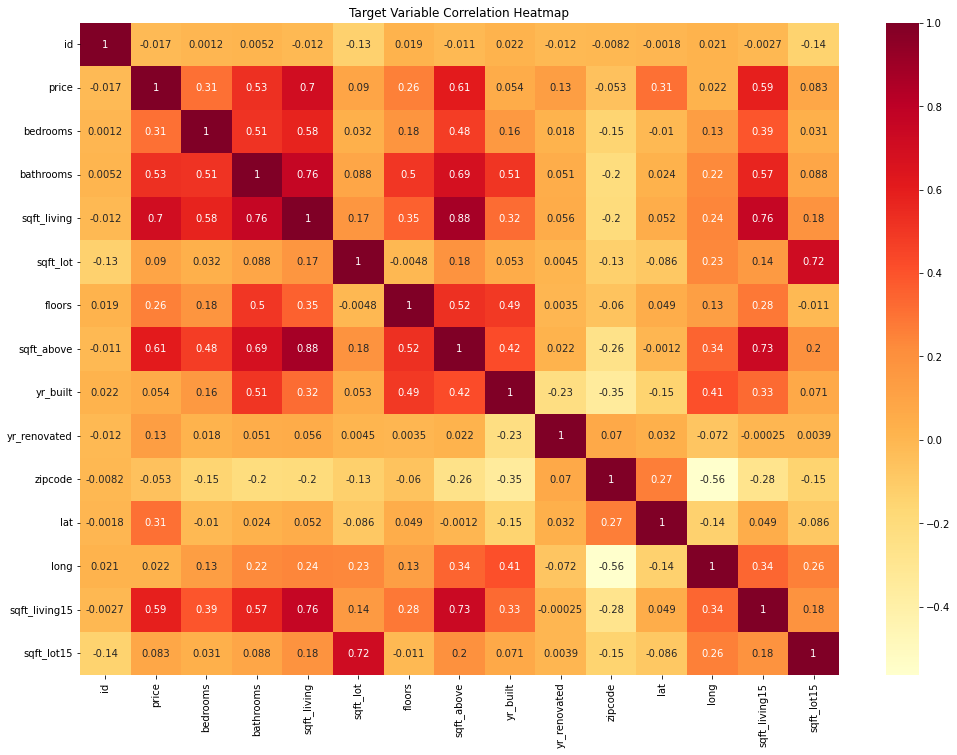

In [149]:
#set up heatmap
fig, ax = plt.subplots(figsize=(17, 12))
corr = df.corr() #use for correlation
sns.heatmap(corr, cmap = 'YlOrRd', annot = True)
# Add title
ax.set_title("Target Variable Correlation Heatmap");

plt.show()


- You can see that the most correlated columns are sqft_living, sqft_lot15, sqft_above, bathrooms and bedrooms.
- A correlation of 0.7 to 1.0 (-0.7 to -1) proposes a strong positive (negative) linear relationship while 0.5 to 0.6 (-0.5 to -0.6) is to be considered moderate.
- Might be some multicollinearity between these variables but we will be able to tell with more eda.

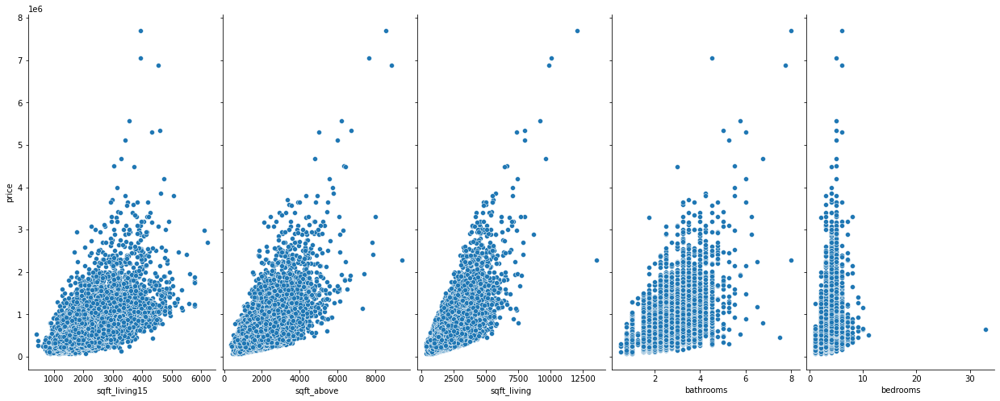

In [150]:
#visualizing the top 5 correlated varibles 
sns.pairplot(df, x_vars=['sqft_living15','sqft_above','sqft_living','bathrooms','bedrooms'], y_vars='price',height=7, aspect=0.5, kind='scatter')

- Looking at the pairplot you can see that all the variables that have sqft all have a cone shape which would indicate that they are indeed correlated.
- You can also see that there are indeed outliers which will need to be cleaned if we're going to use these variables. 

Convert date column to a datetime type

In [151]:
#convert date to datetime 
df['date'] = pd.to_datetime(df['date'])

Let's see if there is a relation between monthly average price and plot to show.

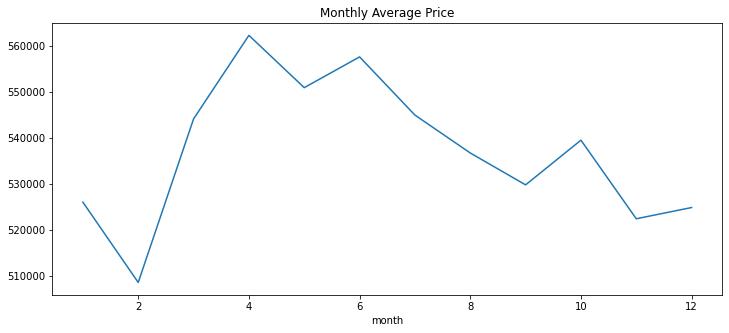

In [153]:
df['month'] = df.date.apply(lambda x: x.month)
#create monthly average plot
fig, ax = plt.subplots(figsize=(12,5))
ax = df.groupby('month').price.mean().plot()
ax.set(title='Monthly Average Price');

There is around a %8 price change between February and March to May. Will drop the date column later and keep the month column as it still has an effect on prices.

/opt/anaconda3/lib/python3.9/site-packages/seaborn/_decorators.py:36: FutureWarning:

Pass the following variables as keyword args: x, y. From version 0.12, the only valid positional argument will be `data`, and passing other arguments without an explicit keyword will result in an error or misinterpretation.



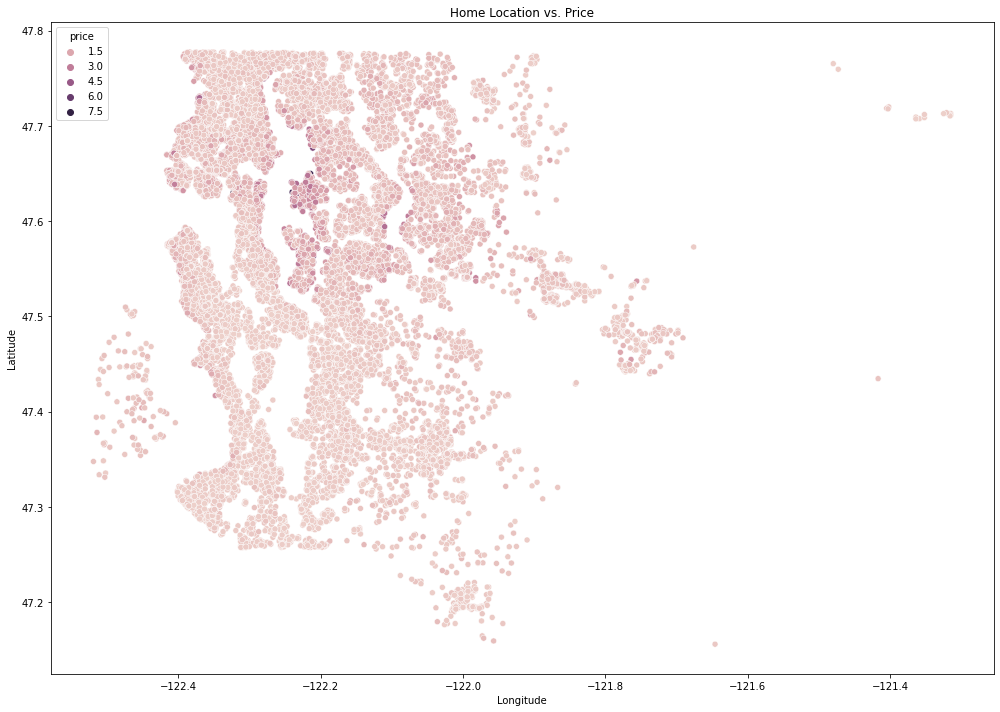

In [154]:
#make scatterplot
plt.figure(figsize=(14, 10))
plt.title('Home Location vs. Price')
sns.scatterplot(df['long'], df['lat'], hue=df['price'])
plt.xlabel('Longitude')
plt.ylabel('Latitude')
plt.tight_layout()

- Created a map using longitude and latitude to show the overall area of Kings County compared to price of the data set to get a more generalized idea. 
- Longitude and latitude might be something very important of use later on.

Make a scatterplot of bathrooms vs. price to see how price varies depending on the number of bathrooms in the home. 

/opt/anaconda3/lib/python3.9/site-packages/seaborn/_decorators.py:36: FutureWarning:

Pass the following variables as keyword args: x, y. From version 0.12, the only valid positional argument will be `data`, and passing other arguments without an explicit keyword will result in an error or misinterpretation.



<AxesSubplot:xlabel='bathrooms', ylabel='price'>

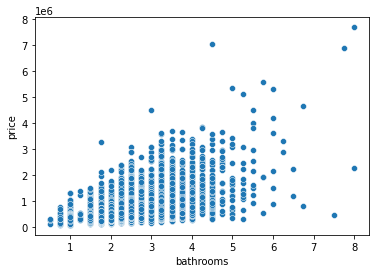

In [155]:
# Scatterplot of bathrooms/bedroom vs. price
sns.scatterplot(df.bathrooms, df.price)

/opt/anaconda3/lib/python3.9/site-packages/seaborn/_decorators.py:36: FutureWarning:

Pass the following variables as keyword args: x, y. From version 0.12, the only valid positional argument will be `data`, and passing other arguments without an explicit keyword will result in an error or misinterpretation.



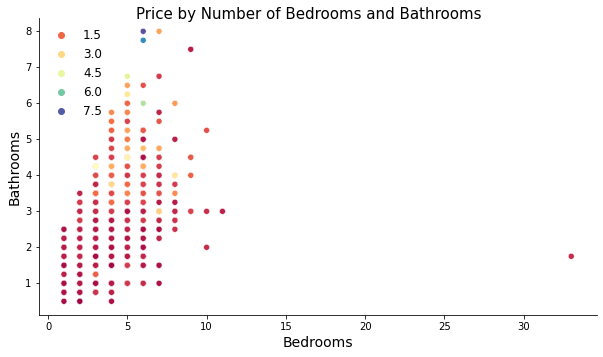

In [156]:
# Scatterplot of number of bedrooms vs. bathrooms, and how this relates to price

fig = plt.gcf()
sns.scatterplot(df.bedrooms, df.bathrooms, hue = df.price,  \
                          palette="Spectral", legend="brief").legend(loc='upper left',   \
                                                                   fontsize = 12, frameon = False)


fig.set_size_inches(10, 5)

plt.xlabel('Bedrooms',size=14)
plt.ylabel('Bathrooms',size=14)
sns.despine()

fig.suptitle('Price by Number of Bedrooms and Bathrooms', fontsize = 15)
fig.subplots_adjust(top=0.95)

As you can see obviously the more bathrooms and bedrooms, the higher the price. Also can see outliers here of over 30 bedrooms which seems like an error but we'll look into that through our cleaning. 

## Data Cleaning and Exploring

Before we can use features in our model to predict price, we need to make sure that these features can be interpreted accurately or interpreted at all so here we will clean the data throughly to get the best predictions.

In [157]:
#Drop all columns that are unnecessary for the project.
#Some multicollinearity between sqft living 15 and sqft lot 15
df = df.drop(['id', 'sqft_living15', 'sqft_lot15'], axis  = 1)
df.columns

Index(['date', 'price', 'bedrooms', 'bathrooms', 'sqft_living', 'sqft_lot',
       'floors', 'waterfront', 'view', 'condition', 'grade', 'sqft_above',
       'sqft_basement', 'yr_built', 'yr_renovated', 'zipcode', 'lat', 'long',
       'month'],
      dtype='object')

In [158]:
#After dropping columns wanted to see which variables are mostly correlated to price
df.corr()['price'].sort_values(ascending=False)

price           1.000000
sqft_living     0.701917
sqft_above      0.605368
bathrooms       0.525906
bedrooms        0.308787
lat             0.306692
floors          0.256804
yr_renovated    0.129599
sqft_lot        0.089876
yr_built        0.053953
long            0.022036
month          -0.009928
zipcode        -0.053402
Name: price, dtype: float64

In [159]:
#data information
df.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 21597 entries, 0 to 21596
Data columns (total 19 columns):
 #   Column         Non-Null Count  Dtype         
---  ------         --------------  -----         
 0   date           21597 non-null  datetime64[ns]
 1   price          21597 non-null  float64       
 2   bedrooms       21597 non-null  int64         
 3   bathrooms      21597 non-null  float64       
 4   sqft_living    21597 non-null  int64         
 5   sqft_lot       21597 non-null  int64         
 6   floors         21597 non-null  float64       
 7   waterfront     19221 non-null  object        
 8   view           21534 non-null  object        
 9   condition      21597 non-null  object        
 10  grade          21597 non-null  object        
 11  sqft_above     21597 non-null  int64         
 12  sqft_basement  21597 non-null  object        
 13  yr_built       21597 non-null  int64         
 14  yr_renovated   17755 non-null  float64       
 15  zipcode        2159

- First thing I noticed is that waterfront, view, and yr_renovated all have missing values. yr_renovated has the most missing values followed by waterfront and view
- Can also see that this data set includes mainly float and int dtypes. 
- Will figure out more during the data cleaning process and what to do with each variable

Let's investigate the "bedrooms" column being that we saw initally that one home had 33 bedrooms.

In [160]:
df[df.bedrooms== 33]

,date,price,bedrooms,bathrooms,sqft_living,sqft_lot,floors,waterfront,view,condition,grade,sqft_above,sqft_basement,yr_built,yr_renovated,zipcode,lat,long,month
15856,2014-06-25,640000.0,33,1.75,1620,6000,1.0,NO,NONE,Very Good,7 Average,1040,580.0,1947,0.0,98103,47.6878,-122.331,6


There is obviously an input error in which one house has 33 bedrooms. Although such houses do exist, the price of this house is less than a million,and it has 1.75 bathrooms and is on 1 floor. I will only show homes that have 10 bedrooms or less so it doesnt influence our predictions. 

In [161]:
#show bedrooms that have 10 or less 
df = df[df['bedrooms'] <= 10]

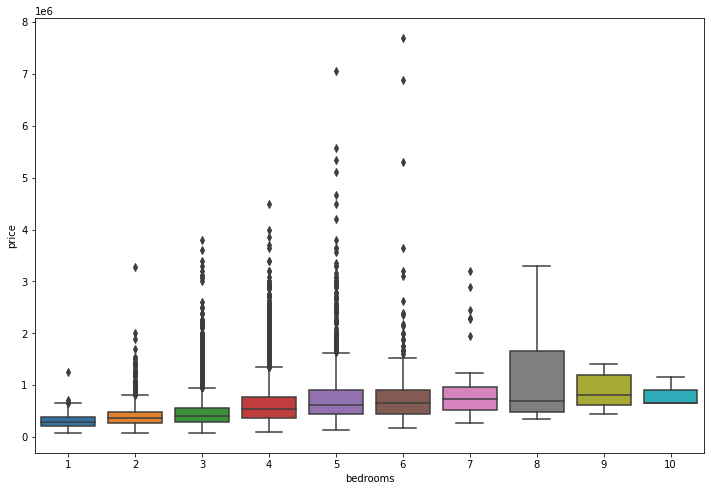

In [223]:
#create boxplot to now show what bedrooms look like in the data set
df['bedrooms'].value_counts()
plt.figure(figsize= (12,8))
sns.boxplot(x='bedrooms', y='price', data=df);

Recreated scatterplot from earlier to show the number of bedrooms vs. bathrooms and how it relates to price.

/opt/anaconda3/lib/python3.9/site-packages/seaborn/_decorators.py:36: FutureWarning:

Pass the following variables as keyword args: x, y. From version 0.12, the only valid positional argument will be `data`, and passing other arguments without an explicit keyword will result in an error or misinterpretation.



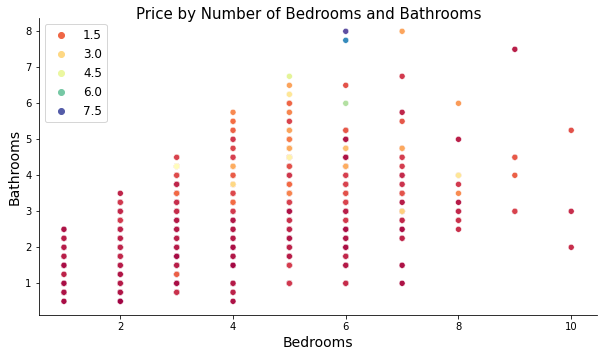

In [163]:
# Scatterplot of number of bedrooms vs. bathrooms, and how this relates to price

fig = plt.gcf()
sns.scatterplot(df.bedrooms, df.bathrooms, hue = df.price,  \
                          palette="Spectral", legend='brief').legend(loc='upper left', fontsize = 12)


fig.set_size_inches(10, 5)

plt.xlabel('Bedrooms',size=14)
plt.ylabel('Bathrooms',size=14)
sns.despine()

fig.suptitle('Price by Number of Bedrooms and Bathrooms', fontsize = 15)
fig.subplots_adjust(top=0.95)

In [164]:
# checking the unique value in the column
df['sqft_basement'].unique() 

array(['0.0', '400.0', '910.0', '1530.0', '?', '730.0', '1700.0', '300.0',
       '970.0', '760.0', '720.0', '700.0', '820.0', '780.0', '790.0',
       '330.0', '1620.0', '360.0', '588.0', '1510.0', '410.0', '990.0',
       '600.0', '560.0', '550.0', '1000.0', '1600.0', '500.0', '1040.0',
       '880.0', '1010.0', '240.0', '265.0', '290.0', '800.0', '540.0',
       '710.0', '840.0', '380.0', '770.0', '480.0', '570.0', '1490.0',
       '620.0', '1250.0', '1270.0', '120.0', '650.0', '180.0', '1130.0',
       '450.0', '1640.0', '1460.0', '1020.0', '1030.0', '750.0', '640.0',
       '1070.0', '490.0', '1310.0', '630.0', '2000.0', '390.0', '430.0',
       '850.0', '210.0', '1430.0', '1950.0', '440.0', '220.0', '1160.0',
       '860.0', '580.0', '2060.0', '1820.0', '1180.0', '200.0', '1150.0',
       '1200.0', '680.0', '530.0', '1450.0', '1170.0', '1080.0', '960.0',
       '280.0', '870.0', '1100.0', '460.0', '1400.0', '660.0', '1220.0',
       '900.0', '420.0', '1580.0', '1380.0', '475.0', 

In [165]:
# dropping row with '?' 
df = df[df.sqft_basement != '?']
#converting sqft_basement from object to float 
df['sqft_basement'] = df['sqft_basement'].astype("float")

In [166]:
# checking if is there any Null values in the dataset
df.isna().sum()

date                0
price               0
bedrooms            0
bathrooms           0
sqft_living         0
sqft_lot            0
floors              0
waterfront       2339
view               61
condition           0
grade               0
sqft_above          0
sqft_basement       0
yr_built            0
yr_renovated     3754
zipcode             0
lat                 0
long                0
month               0
dtype: int64

In [167]:
#what are the unique values in waterfront column?
df['waterfront'].unique()

array([nan, 'NO', 'YES'], dtype=object)

The unique values in waterfront column are NAN, NO and YES. The NAN is not suppose to be there so we will replace those values with 'NO'

In [168]:
#replace values with NO
df['waterfront'].fillna('NO', inplace=True)

#make sure change was made
df['waterfront'].value_counts()

NO     20999
YES      142
Name: waterfront, dtype: int64

The most common value in this column is NO with 20999 entries while YES has only 142. I would assume that this means most of these houses in the data set don't have a waterfront hence I think it's safe to assume that the ones with missing values also don't have a waterfront. Therefore, I replaced the missing values with NO.

In [169]:
# convert waterfront with the values 'NO' and 'YES' with '0' and '1' 
df['waterfront'].replace({'NO': 0, 'YES': 1}, inplace=True)

#convert column to data type 'int'
df['waterfront'].astype(int)

#confirm if change was made 

df['waterfront'].unique()

array([0, 1])

Changed the waterfront column to dtype of int and now show values of 0 and 1. Created a boxplot to now show the changes. 

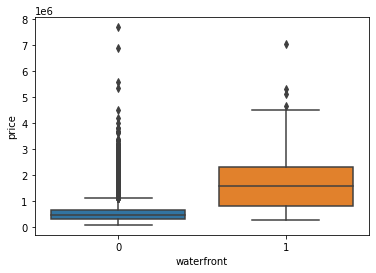

In [170]:
#create box plot
sns.boxplot(x=df['waterfront'], y=df['price'])
plt.savefig('waterfront')

Lets investigate the "view" column

In [171]:
df['view'].value_counts()

NONE         19016
AVERAGE        930
GOOD           496
FAIR           327
EXCELLENT      311
Name: view, dtype: int64

In [172]:
#checking to see what are the unique values are in this column
df['view'].unique()

array(['NONE', nan, 'GOOD', 'EXCELLENT', 'AVERAGE', 'FAIR'], dtype=object)

NAN should not be a part of the unqiue values. Lets see how many are in this column. 

In [173]:
#count how many NANs there are 
df['view'].isnull().sum()

61

There are 61 values that are associated with NAN. The most common value is NONE which we can assume that most of the homes in this data set dont have a view. It makes sense to replace the missing values with 'NONE'

In [174]:
#replace values with NONE
df['view'].fillna('NONE', inplace=True)

#check to make sure change was made
df['view'].value_counts()


NONE         19077
AVERAGE        930
GOOD           496
FAIR           327
EXCELLENT      311
Name: view, dtype: int64

In [175]:
#convert view to numerical
df.view.replace({'NONE': 0, 'FAIR': 1, 'AVERAGE': 2, 'GOOD': 3, 'EXCELLENT': 4}, inplace=True)

#convert column to data type 'int'
df['view'].astype(int)

#confirm if change was made 
df['view'].unique()

array([0, 3, 4, 2, 1])

Changed the view column to dtype of int and now show values of 0, 1, 2, 3, and 4. Created a barplot to now show the changes. 

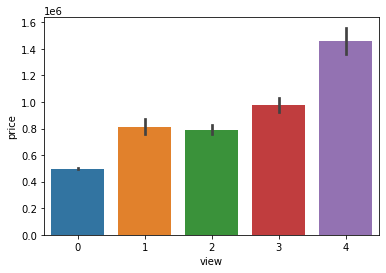

In [176]:
sns.barplot(x=df['view'], y=df['price'])
plt.savefig('view')

Now we'll investigate the "yr_renovated" column in which this had the most null values

In [177]:
df['yr_renovated'].value_counts()

0.0       16665
2014.0       69
2003.0       31
2013.0       31
2007.0       30
          ...  
1959.0        1
1951.0        1
1976.0        1
1953.0        1
1948.0        1
Name: yr_renovated, Length: 69, dtype: int64

In [178]:
#checking to see what are the unique values are in this column
df['yr_renovated'].unique()

array([   0., 1991.,   nan, 2002., 2010., 1992., 2013., 1994., 1978.,
       2005., 2003., 1984., 1954., 2014., 2011., 1983., 1945., 1990.,
       1988., 1977., 1981., 1995., 2000., 1999., 1998., 1970., 1989.,
       2004., 1986., 2007., 1987., 2006., 1985., 1980., 1971., 1979.,
       1997., 1950., 1969., 1948., 2009., 2015., 1974., 2008., 1968.,
       2012., 1963., 1951., 1962., 2001., 1953., 1993., 1996., 1955.,
       1982., 1956., 1940., 1976., 1975., 1964., 1973., 1957., 1959.,
       1960., 1967., 1965., 1934., 1972., 1944., 1958.])

In [179]:
#count how many NANs there are 
df['yr_renovated'].isnull().sum()

3754

The most common value in this column is 0.0 with 3754 entries. The years run from 1948 to 2014. It's impossible to know what 0.0 stands for so we'll have the missing values as 0.0 reason being that it's the most common entry.

In [180]:
#replace null values with 0.0
df['yr_renovated'].fillna(0.0, inplace=True)

#check to make sure change was made
df['yr_renovated'].value_counts()

0.0       20419
2014.0       69
2003.0       31
2013.0       31
2007.0       30
          ...  
1959.0        1
1951.0        1
1976.0        1
1953.0        1
1948.0        1
Name: yr_renovated, Length: 69, dtype: int64

With 0.0 increasing to 20419 means that the changes were made 

In [181]:
#Double checking to make sure there are no more null values
df.isnull().sum()

date             0
price            0
bedrooms         0
bathrooms        0
sqft_living      0
sqft_lot         0
floors           0
waterfront       0
view             0
condition        0
grade            0
sqft_above       0
sqft_basement    0
yr_built         0
yr_renovated     0
zipcode          0
lat              0
long             0
month            0
dtype: int64

Investingated condition column and changed the condition score to numerical instead of objects. 

In [182]:
#convert condition score to numberical
df.condition.replace({'Poor': 0, 'Fair': 1, 'Average': 2, 'Good': 3, 'Very Good': 4}, inplace=True)

#convert column to data type 'int'
df['condition'].astype(int)

#confirm if change was made 
df['condition'].unique()

array([2, 4, 3, 0, 1])

Plot condition to show the changes made 

<AxesSubplot:xlabel='condition', ylabel='price'>

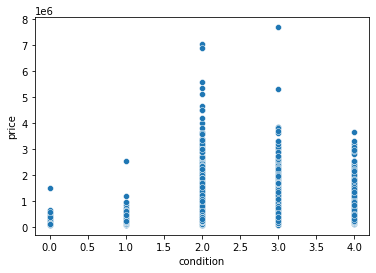

In [183]:
#create scatterplot for condition
sns.scatterplot(x=df['condition'], y=df['price'])


Now let's investigate the grade column in which it seems similar to the condition column

In [184]:
df['grade'].value_counts()

7 Average        8786
8 Good           5933
9 Better         2557
6 Low Average    1997
10 Very Good     1112
11 Excellent      391
5 Fair            235
12 Luxury          89
4 Low              27
13 Mansion         13
3 Poor              1
Name: grade, dtype: int64

In [185]:
#convert condition score to numerical
df.grade.replace({'3 Poor': 0, '4 Low': 1, '5 Fair': 2, '6 Low Average': 3, '7 Average': 4, '8 Good': 5, '9 Better': 6, '10 Very Good': 7, '11 Excellent': 8, '12 Luxury': 9, '13 Mansion': 10}, inplace=True)

#convert column to data type 'int'
df['grade'].astype(int)

#confirm if change was made 
df['grade']

0        4
1        4
2        3
3        4
4        5
        ..
21592    5
21593    5
21594    4
21595    5
21596    4
Name: grade, Length: 21141, dtype: int64

- Changed the column to numerical and changed the grade to 0-10 respectively.

Wanted to capture the mean and median of price overall to see exactly what the average price of the data set looked like. The median of the homes in the data set could also be helpful as well. 

In [188]:
#mean
print(df.price.mean())
#median
print(df.price.median())

540506.991627643
450000.0


Create histogram to give a better idea of what the avg price looks like visually. 

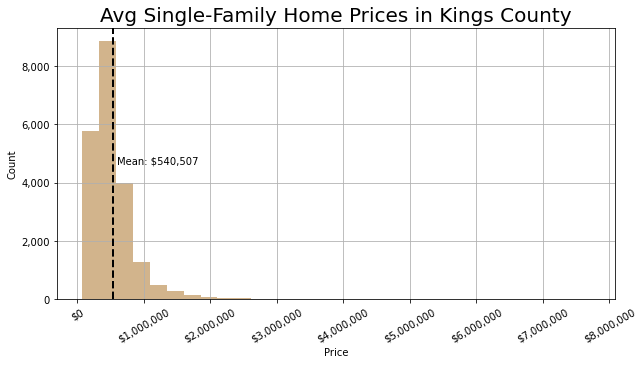

In [189]:
# Create figure and set figure size
fig, ax = plt.subplots(figsize = (10,5))

# Plot histogram of price variable
df.price.hist(bins=30, facecolor='tan')

# Plot vertical line representing mean price
plt.axvline(df.price.mean(), color='black', linestyle='dashed', linewidth=2)
min_ylim, max_ylim = plt.ylim()
plt.text(df.price.mean()*1.1, max_ylim*0.5, 'Mean: ${:,.0f}'.format(df.price.mean()))

# Format xticks by including $ sign, adding commas, and removing decimals
ax.xaxis.set_major_formatter(StrMethodFormatter('${x:,.0f}'))
# Rotate x-ticks 
plt.xticks(rotation=30)
# Set x-label
plt.xlabel('Price')

# Set y-label
plt.ylabel('Count')
# Format yticks by adding commas and removing decimals
ax.yaxis.set_major_formatter(StrMethodFormatter('{x:,.0f}'))


#title
plt.title('Avg Single-Family Home Prices in Kings County', fontsize=20)

plt.show;

- Can see that the avg price of the homes are about $540,000 which is a bit above our stakeholders budget. We will further investigate this once we create our models. 

Wanted to see the comparison of the amount of bathrooms, bedrooms, and floors are in the data set to get a better idea of the homes in the area. Used the mode function to achieve this. 

In [190]:
#bathrooms mode
print(df.bathrooms.mode())
#bedrooms mode
print(df.bedrooms.mode())
#floors mode 
print(df.floors.mode()) 

0    2.5
Name: bathrooms, dtype: float64
0    3
Name: bedrooms, dtype: int64
0    1.0
Name: floors, dtype: float64


Captured the findings visually in a bar chart.

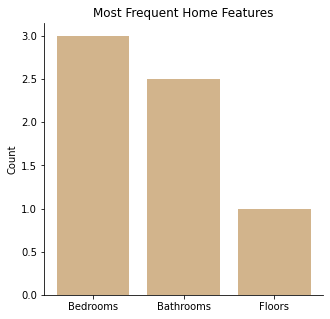

In [191]:
# Mode: Barplots of mode number of bedrooms, bathrooms, sqft_above

# Create figure and set figure size
fig, ax = plt.subplots(figsize=(5,5))

# Create dictionary with mode values for bedrooms, bathrooms, floors
mode_dictionary = {u'Bedrooms':3, u'Bathrooms': 2.5, u'Floors':1}

# Plot bar chart
plt.bar(*zip(*mode_dictionary.items()), color='tan')

# Rotate x-ticks
plt.xticks(rotation=0)

# Set y-label
plt.ylabel('Count')

# Remove top and right borders from plot
sns.despine()

# Set title
plt.title('Most Frequent Home Features')

plt.show;

- Can see that the homes in the data set mostly have at least 3 bedrooms, 2 bathrooms and 1 floor which lines up with our stakeholders requests. 

In [192]:
#check how data looks after changes 
df.info()

<class 'pandas.core.frame.DataFrame'>
Int64Index: 21141 entries, 0 to 21596
Data columns (total 19 columns):
 #   Column         Non-Null Count  Dtype         
---  ------         --------------  -----         
 0   date           21141 non-null  datetime64[ns]
 1   price          21141 non-null  float64       
 2   bedrooms       21141 non-null  int64         
 3   bathrooms      21141 non-null  float64       
 4   sqft_living    21141 non-null  int64         
 5   sqft_lot       21141 non-null  int64         
 6   floors         21141 non-null  float64       
 7   waterfront     21141 non-null  int64         
 8   view           21141 non-null  int64         
 9   condition      21141 non-null  int64         
 10  grade          21141 non-null  float64       
 11  sqft_above     21141 non-null  int64         
 12  sqft_basement  21141 non-null  float64       
 13  yr_built       21141 non-null  int64         
 14  yr_renovated   21141 non-null  float64       
 15  zipcode        2114

- After looking at the info of the data you can see that all major changes were made and the data looks fully cleaned up. No more objects in the dtypes sections which means we are ready to model

## Baseline Model - Model 1

We chose to start with a Baseline model with a simple linear regression that uses sqft_living as it's feature, since it appears to have one of the highest correlation with price amongst the variables.

### Train Test Split

In [193]:
# set up our target variable for train-test split
X = df.drop('price', axis=1)
y = df['price']


# separate the data into a train test split before performing preprocessing
X_train, X_test, y_train, y_test = train_test_split(X, y, test_size = .33, random_state = 42)
print(X_train.shape, y_train.shape)
print(X_test.shape, y_test.shape)

(14164, 18) (14164,)
(6977, 18) (6977,)


In [194]:
# used ordinal encoder for view and condition
categor_sub = X_train[['view', 'condition']]
list_view = [0, 1, 2, 3, 4]
list_condition = [0, 1, 2, 3, 4]
# list_grade = [0, 1, 2, 3, 4, 5, 6, 7, 8, 9, 10]
or_enc = OrdinalEncoder(categories = [list_view, list_condition])
#fit the categories of condition and view
or_enc.fit(categor_sub)
#create dataframe and transform the subset of view and condition
x_subset = pd.DataFrame(or_enc.transform(categor_sub), columns = categor_sub.columns)

In [195]:
#one hot encode waterfront and zipcode
ohe = OneHotEncoder(handle_unknown = 'ignore', drop = 'first', sparse = False)
temp = pd.DataFrame(ohe.fit_transform(X_train[['waterfront', 'zipcode']]), columns = ohe.get_feature_names_out())
X_train.reset_index(inplace = True)
X_train = pd.concat([X_train, temp], axis = 1)
X_train = X_train.drop(['waterfront', 'zipcode'], axis = 1)
X_train


,index,date,bedrooms,bathrooms,sqft_living,sqft_lot,floors,view,condition,grade,...,zipcode_98146,zipcode_98148,zipcode_98155,zipcode_98166,zipcode_98168,zipcode_98177,zipcode_98178,zipcode_98188,zipcode_98198,zipcode_98199
0,18677,2014-09-15,4,1.75,2230,7957,1.0,0,3,43.308060,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
1,16360,2014-10-08,5,3.50,2660,6978,2.0,0,2,79.432359,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
2,15514,2015-01-23,3,1.75,2110,56192,1.0,0,2,43.308060,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
3,10286,2014-11-07,2,1.50,1080,6760,1.0,2,2,19.812991,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
4,15437,2014-07-18,4,1.75,2220,6350,1.0,0,2,43.308060,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
14159,11520,2014-07-22,5,2.75,2930,31411,1.0,0,3,130.387033,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
14160,12214,2014-06-05,4,2.25,2192,12128,2.0,0,2,79.432359,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
14161,5491,2014-06-20,2,1.75,1760,4400,1.0,0,3,43.308060,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
14162,876,2014-11-25,3,2.00,1910,11576,1.0,0,2,43.308060,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0


In [196]:
temp2 = pd.DataFrame(ohe.transform(X_test[['waterfront', 'zipcode']]), columns = ohe.get_feature_names_out())
temp2

,waterfront_1,zipcode_98002,zipcode_98003,zipcode_98004,zipcode_98005,zipcode_98006,zipcode_98007,zipcode_98008,zipcode_98010,zipcode_98011,...,zipcode_98146,zipcode_98148,zipcode_98155,zipcode_98166,zipcode_98168,zipcode_98177,zipcode_98178,zipcode_98188,zipcode_98198,zipcode_98199
0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,1.0,0.0
1,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
2,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
3,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
4,0.0,1.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
6972,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
6973,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
6974,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
6975,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0


In [197]:
# Reset index of test and check the shape
X_test.reset_index(inplace = True)
X_test.shape

(6977, 19)

In [198]:

X_test = pd.concat([X_test, temp2], axis = 1)
X_test = X_test.drop(['waterfront', 'zipcode'], axis = 1)
X_test

,index,date,bedrooms,bathrooms,sqft_living,sqft_lot,floors,view,condition,grade,...,zipcode_98146,zipcode_98148,zipcode_98155,zipcode_98166,zipcode_98168,zipcode_98177,zipcode_98178,zipcode_98188,zipcode_98198,zipcode_98199
0,20447,2015-02-26,3,2.50,2730,7136,2.0,0,2,79.432359,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,1.0,0.0
1,483,2014-10-27,3,1.50,1350,6000,1.0,2,2,43.308060,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
2,14372,2014-08-25,3,2.00,3570,30456,1.0,1,2,79.432359,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
3,6225,2014-06-30,4,2.50,2960,6031,2.0,0,2,130.387033,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
4,21124,2015-02-26,3,2.25,1481,2820,2.0,0,2,43.308060,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
6972,10047,2014-09-19,2,1.75,1680,8187,1.0,0,3,79.432359,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
6973,3158,2014-10-10,3,1.50,1620,7500,1.0,2,3,79.432359,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
6974,20657,2014-09-19,2,1.75,1460,1500,2.0,0,2,79.432359,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
6975,88,2014-05-19,2,2.25,1610,2040,2.0,0,3,43.308060,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0


In [199]:
# Base model 1
lr1 = LinearRegression()
#fit the model
lr1.fit(X_train[['sqft_living']], y_train)
#check r_squared train
r2_train1 = lr1.score(X_train[['sqft_living']], y_train)

#create prediction
preds = lr1.predict(X_test[['sqft_living']])
#check r_squared test
r2_test1 = lr1.score(X_test[['sqft_living']], y_test)


# Print our R squared for train and test
print('Base Model Train R-Squared:', (r2_train1))
print('Base Model Test R-Squared:', (r2_test1))
print()

#calculate mean absolute error
test_mae = mean_absolute_error(preds, y_test)
print('Test Mean Absolute Error:', test_mae)
#calculate root mean squared error
test_rmse = (mean_squared_error(preds, y_test, squared=False))
print('Test Root Mean Squared Error:', test_rmse)

print('1st Model Predictions:', preds[0])

Base Model Train R-Squared: 0.49420226272358503
Base Model Test R-Squared: 0.49145991115724263

Test Mean Absolute Error: 175656.17287001616
Test Root Mean Squared Error: 262744.22445694887
1st Model Predictions: 722947.2469433764


In [200]:
#show first model results in a scatterplot
fig = px.scatter(x = preds,y = y_test, trendline = 'ols')
fig.show('notebook')

- First model did not give us good results in which it gave us an R-squared of .49 which is not where we want to be. Also got a MAE of 175,656 and a RSME of 262,744. Our can be way better in which that seems pretty high for a price prediciton. This model also wasn't scaled which might've also had an effect on the model as well. Will test different models to try to decrease our error as much as possible.

# Model 2 - Structural Features vs. Price

Here we will use the structural features of the home to see if it improves our model and decreases our error.

In [201]:
#drop date due to its not necessary
X_train = X_train.drop('date', 1)

/var/folders/83/sb2tv79n3r11w7g4_w_37bmr0000gn/T/ipykernel_8191/3786569391.py:1: FutureWarning:

In a future version of pandas all arguments of DataFrame.drop except for the argument 'labels' will be keyword-only.



In [204]:
#scale the data
ss = StandardScaler()
X_train_scaled = X_train
X_test_scaled = X_test

In [205]:
#bedrooms scaled
X_train_scaled['bedrooms'] = ss.fit_transform(X_train[['bedrooms']])
X_test_scaled['bedrooms'] = ss.transform(X_test[['bedrooms']])
#bathrooms scaled
X_train_scaled['bathrooms'] = ss.fit_transform(X_train[['bathrooms']])
X_test_scaled['bathrooms'] = ss.transform(X_test[['bathrooms']])
#sqft living scaled
X_train_scaled['sqft_living'] = ss.fit_transform(X_train[['sqft_living']])
X_test_scaled['sqft_living'] = ss.transform(X_test[['sqft_living']])
#sqft lot scaled
X_train_scaled['sqft_lot'] = ss.fit_transform(X_train[['sqft_lot']])
X_test_scaled['sqft_lot'] = ss.transform(X_test[['sqft_lot']])
#floors scaled 
X_train_scaled['floors'] = ss.fit_transform(X_train[['floors']])
X_test_scaled['floors'] = ss.transform(X_test[['floors']])
#grade scaled 
X_train_scaled['grade'] = ss.fit_transform(X_train[['grade']])
X_test_scaled['grade'] = ss.transform(X_test[['grade']])
#sqft above scaled 
X_train_scaled['sqft_above'] = ss.fit_transform(X_train[['sqft_above']])
X_test_scaled['sqft_above'] = ss.transform(X_test[['sqft_above']])
#yr renovated scaled
X_train_scaled['yr_renovated'] = ss.fit_transform(X_train[['yr_renovated']])
X_test_scaled['yr_renovated'] = ss.transform(X_test[['yr_renovated']])
#lat scaled 
X_train_scaled['lat'] = ss.fit_transform(X_train[['lat']])
X_test_scaled['lat'] = ss.transform(X_test[['lat']])
#long scaled
X_train_scaled['long'] = ss.fit_transform(X_train[['long']])
X_test_scaled['long'] = ss.transform(X_test[['long']])

In [207]:
# create Model 2
lr2 = LinearRegression()
# fit the model
lr2.fit(X_train_scaled[['bathrooms','floors','sqft_basement', 'bedrooms', 'sqft_living']], y_train)
# check r_squared train
r2_train2 = lr2.score(X_train_scaled[['bathrooms','floors','sqft_basement', 'bedrooms', 'sqft_living']], y_train)
# create prediction
preds2 = lr2.predict(X_test_scaled[['bathrooms','floors','sqft_basement','bedrooms', 'sqft_living']])
# check r squared test
r2_test2 = lr2.score(X_test_scaled[['bathrooms','floors','sqft_basement','bedrooms', 'sqft_living']], y_test)


# Print our R squared for train and test
print('2nd Model Train R-Squared:', (r2_train2))
print('2nd Model Test R-Squared:', (r2_test2))
print()

#calculate mean absolute error
test_mae2 = mean_absolute_error(preds2, y_test)
print('Test Mean Absolute Error:', test_mae2)
#calculate root mean squared error
test_rmse2 = (mean_squared_error(preds2, y_test, squared=False))
print('Test Root Mean Squared Error:', test_rmse2)

print('2nd Model Predictions:', preds2[0])

2nd Model Train R-Squared: 0.5108567435407378
2nd Model Test R-Squared: 0.5087860915551589

Test Mean Absolute Error: 171357.75396184184
Test Root Mean Squared Error: 258229.532252206
2nd Model Predictions: 761402.0057189676


In [208]:
fig = px.scatter(x = preds2,y = y_test, trendline = 'ols')
fig.show('notebook')

As we can see our R squared is .510 which is still nowhere close to where we want to be even though it did get a little better. Our error decreased a little as well compared to the first model but still not substantial enough to make honest predictions. 

## Model 3 - Selling Features vs. Price

Here we will use selling features to see if we can get better results on our model and decrease our error.

In [209]:
# create model 3
lr3 = LinearRegression()
# fit the model
lr3.fit(X_train_scaled[['waterfront_1','sqft_lot','condition', 'yr_renovated', 'grade','yr_built', 'view' ]], y_train)
# check r squared train
r2_train3 = lr3.score(X_train_scaled[['waterfront_1','sqft_lot','condition', 'yr_renovated', 'grade','yr_built', 'view']], y_train)
# create prediciton
preds3 = lr3.predict(X_test_scaled[['waterfront_1','sqft_lot','condition', 'yr_renovated', 'grade','yr_built', 'view']])
# check r squared test
r2_test3 = lr3.score(X_test_scaled[['waterfront_1','sqft_lot','condition', 'yr_renovated', 'grade','yr_built', 'view']], y_test)


# Print our R squared for train and test
print('3rd Model Train R-Squared:', (r2_train3))
print('3rd Model Test R-Squared:', (r2_test3))
print()

#calculate mean absolute error
test_mae3 = mean_absolute_error(preds3, y_test)
print('Test Mean Absolute Error:', test_mae3)
#calculate root mean squared error
test_rmse3 = (mean_squared_error(preds3, y_test, squared=False))
print('Test Root Mean Squared Error:', test_rmse3)

print('3rd Model Predictions:', preds3[0])

3rd Model Train R-Squared: 0.6121040053066134
3rd Model Test R-Squared: 0.6231188716207874

Test Mean Absolute Error: 146334.17111024229
Test Root Mean Squared Error: 226189.67510556325
3rd Model Predictions: 426852.3511758018


In [210]:
fig = px.scatter(x = preds3,y = y_test, trendline = 'ols')
fig.show('notebook')

- Our R squared is now .612 which is improving but still nowhere close to where we want to be. Our error decreased a little more as well compared to the first and second model but still not substantial enough to make true predictions. 

## Model 4 - Location Related Variables

Here we will use the location related features of the home to see if it improves our model and decreases our error.

In [211]:
#create a list of location related variables
locations = ['long', 'lat', 'zipcode_98002',
       'zipcode_98003', 'zipcode_98004', 'zipcode_98005', 'zipcode_98006',
       'zipcode_98007', 'zipcode_98008', 'zipcode_98010', 'zipcode_98011',
       'zipcode_98014', 'zipcode_98019', 'zipcode_98022', 'zipcode_98023',
       'zipcode_98024', 'zipcode_98027', 'zipcode_98028', 'zipcode_98029',
       'zipcode_98030', 'zipcode_98031', 'zipcode_98032', 'zipcode_98033',
       'zipcode_98034', 'zipcode_98038', 'zipcode_98039', 'zipcode_98040',
       'zipcode_98042', 'zipcode_98045', 'zipcode_98052', 'zipcode_98053',
       'zipcode_98055', 'zipcode_98056', 'zipcode_98058', 'zipcode_98059',
       'zipcode_98065', 'zipcode_98070', 'zipcode_98072', 'zipcode_98074',
       'zipcode_98075', 'zipcode_98077', 'zipcode_98092', 'zipcode_98102',
       'zipcode_98103', 'zipcode_98105', 'zipcode_98106', 'zipcode_98107',
       'zipcode_98108', 'zipcode_98109', 'zipcode_98112', 'zipcode_98115',
       'zipcode_98116', 'zipcode_98117', 'zipcode_98118', 'zipcode_98119',
       'zipcode_98122', 'zipcode_98125', 'zipcode_98126', 'zipcode_98133',
       'zipcode_98136', 'zipcode_98144', 'zipcode_98146', 'zipcode_98148',
       'zipcode_98155', 'zipcode_98166', 'zipcode_98168', 'zipcode_98177',
       'zipcode_98178', 'zipcode_98188', 'zipcode_98198', 'zipcode_98199']
X_train[locations]


,long,lat,zipcode_98002,zipcode_98003,zipcode_98004,zipcode_98005,zipcode_98006,zipcode_98007,zipcode_98008,zipcode_98010,...,zipcode_98146,zipcode_98148,zipcode_98155,zipcode_98166,zipcode_98168,zipcode_98177,zipcode_98178,zipcode_98188,zipcode_98198,zipcode_98199
0,0.651269,0.183127,0.0,0.0,0.0,0.0,0.0,0.0,1.0,0.0,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
1,0.014202,-2.153524,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
2,0.538013,1.516495,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
3,-1.217461,1.014854,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
4,-0.537923,1.107509,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
14159,0.198244,-0.021728,0.0,0.0,0.0,0.0,1.0,0.0,0.0,0.0,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
14160,0.099144,-1.420244,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
14161,-0.891849,0.647128,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
14162,0.113301,1.266760,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0


In [212]:
#create model 4
lr4 = LinearRegression()
#fit model
lr4.fit(X_train_scaled[locations], y_train)
#check r squared train
r2_train4 = lr4.score(X_train_scaled[locations], y_train)
#calculate prediction
preds4 = lr4.predict(X_test_scaled[locations])
#check r squared test
r2_test4 = lr4.score(X_test_scaled[locations], y_test)


# Print our R squared for train and test
print('4th Model Train R-Squared:', (r2_train4))
print('4th Model Test R-Squared:', (r2_test4))
print()

#calculate mean absolute error
test_mae4 = mean_absolute_error(preds4, y_test)
print('Test Mean Absolute Error:', test_mae4)
#calculate root mean squared error
test_rmse4 = (mean_squared_error(preds4, y_test, squared=False))
print('Test Root Mean Squared Error:', test_rmse4)

print('4th Model Predictions:', preds4[0])

4th Model Train R-Squared: 0.4095430575828415
4th Model Test R-Squared: 0.3983792584965772

Test Mean Absolute Error: 162652.85968852325
Test Root Mean Squared Error: 285780.09832619637
4th Model Predictions: 298757.5409266108


In [213]:
fig = px.scatter(x = preds4,y = y_test, trendline = 'ols')
fig.show('notebook')

- This was our worst model so far. This model created a r squared of .409 which is less than the first three models. The error increased as well to which is the opposite of how we want our model to perform. Will test different variables to see if we can increase our r squared. 

## Model 5 - Combination of Important Features in Home

In [214]:
#create model 5
lr5 = LinearRegression()
col = ['waterfront_1','sqft_lot','condition', 'sqft_living', 'grade'] + locations
#fit model
lr5.fit(X_train_scaled[col] , y_train)
# check r squared train
r2_train5 = lr5.score(X_train_scaled[col] , y_train)
# create prediction
preds5 = lr5.predict(X_test_scaled[col])
# check r squared test
r2_test5 = lr5.score(X_test_scaled[col], y_test)


# Print our R squared for train and test
print('5th Model Train R-Squared:', (r2_train5))
print('5th Model Test R-Squared:', (r2_test5))
print()

#calculate mean absolute error
test_mae5 = mean_absolute_error(preds5, y_test,)
print('Test Mean Absolute Error:', test_mae5)
#calculate root mean squared error
test_rmse5 = (mean_squared_error(preds5, y_test, squared = False))
print('Test Root Mean Squared Error:', test_rmse5)

print('5th Model Predictions:', preds5[0])

5th Model Train R-Squared: 0.8062967463540595
5th Model Test R-Squared: 0.8066386317321093

Test Mean Absolute Error: 98078.25833404111
Test Root Mean Squared Error: 162015.07877957137
5th Model Predictions: 462557.55588134413


In [215]:
import plotly.express as px
fig = px.scatter(x = preds5,y = y_test, trendline = 'ols')
fig.show('notebook')

- This is our best model of all. Our r squared is .81 which is what you can ask for when creating a model. Our error also decreased immensely to give us a MSE of under 100k and a RSME of 162k. When trying to create a model to predict house prices, an error of plus or minus 98,078 should give us our best bet. Our final prediction is to buy a home of $462,557 which is well within our stakeholders price budget. 

# Recommendations / Next Steps

Based off our predictions here we can see that a home around $462,000 would be best for our stakeholders in which it falls right within their budget. Through trial and error our predictive model went from around 50% to 81% as we increased the complexity of the model. A model like this would be interesting to see if it was linked to more moden data. If I had more time, it would also be interesting to see a much larger data set to see how the model would perform then as well.